In [1]:
import os
import cv2
import random
import joblib
import numpy as np
import pandas as pd
from tqdm import tqdm
import matplotlib.pyplot as plt

# Pytorch Imports
import torch
import torch.nn as nn
import timm

# Sklearn Imports
from sklearn.metrics import accuracy_score, f1_score
from sklearn.utils import shuffle
from sklearn.preprocessing import LabelEncoder

# Albumentations for augmentations
import albumentations as A
from albumentations.pytorch import ToTensorV2

# For descriptive error messages
os.environ['CUDA_LAUNCH_BLOCKING'] = "1"

plt.style.use('dark_background')

In [2]:
ROOT_DIR = "landmark_retrieval_dataset/"
TRAIN_DIR = ROOT_DIR + "train"
TEST_DIR = ROOT_DIR + "test"
MODEL_FILE = "ACC0.6051_epoch3.bin"
NUM_LANDMARKS_ANALYSIS = 20
NUM_IMAGES_ANALYSIS = 200

In [3]:
CONFIG = dict(
    seed=42,
    model_name='tf_mobilenetv3_small_100',
    train_batch_size=384,
    valid_batch_size=768,
    img_size=224,
    epochs=3,
    learning_rate=5e-4,
    scheduler=None,
    # min_lr = 1e-6,
    # T_max = 20,
    # T_0 = 25,
    # warmup_epochs = 0,
    weight_decay=1e-6,
    n_accumulate=1,
    # n_fold=10,
    num_classes=81313,
    device=torch.device("cuda:0" if torch.cuda.is_available() else "cpu"),
    competition='GOOGL',
    _wandb_kernel='deb'
)

In [4]:
def set_seed(seed=42):
    """Sets the seed of the entire notebook so results are the same every time we run. This is for REPRODUCIBILITY."""
    np.random.seed(seed)
    random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    # When running on the CuDNN backend, two further options must be set
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = True
    # Set a fixed value for the hash seed
    os.environ['PYTHONHASHSEED'] = str(seed)

In [5]:
predict_transform = A.Compose(
    [A.Resize(CONFIG['img_size'], CONFIG['img_size']),
     A.Normalize(
         mean=[0.485, 0.456, 0.406],
         std=[0.229, 0.224, 0.225],
         max_pixel_value=255.0,
         p=1.0
     ),
     ToTensorV2()], p=1.)

In [6]:
class LandmarkRetrievalModel(nn.Module):
    def __init__(self, model_name, pretrained=True):
        super(LandmarkRetrievalModel, self).__init__()
        self.model = timm.create_model(model_name, pretrained=pretrained)
        self.n_features = self.model.classifier.in_features
        self.model.reset_classifier(0)
        self.fc = nn.Linear(self.n_features, CONFIG['num_classes'])

    def forward(self, x):
        features = self.model(x)  # features = (bs, embedding_size)
        output = self.fc(features)  # outputs = (bs, num_classes)
        return output

    def extract_features(self, x):
        features = self.model(x)  # features = (bs, embedding_size)
        return features

In [7]:
def predict_image(image_path, model):
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = predict_transform(image=img)["image"]
    img = img.to(CONFIG["device"], dtype=torch.float).unsqueeze_(0)
    output = model(img)
    index = output.data.cpu().numpy().argmax()
    return int(joblib.load('label_encoder.pkl').classes_[index])

In [8]:
def predict_dataset(model, df):
    model.eval()
    PREDS = []
    bar = tqdm(df.itertuples(index=False), total=df.shape[0])
    for images in bar:
        PREDS.append(predict_image(images.file_path, model))
    PREDS = np.array(PREDS)
    return PREDS

In [9]:
set_seed(CONFIG['seed'])
model = LandmarkRetrievalModel(CONFIG['model_name'])
model.to(CONFIG['device'])
model.load_state_dict(torch.load(MODEL_FILE))

<All keys matched successfully>

In [10]:
df_landmarks = pd.read_csv(f"{ROOT_DIR}train_label_to_landmark.csv")
df = pd.read_csv(f"{ROOT_DIR}train.csv")
df = df.merge(df_landmarks, on='landmark_id')
df['file_path'] = df['id'].apply(lambda id: f"{TRAIN_DIR}/{id[0]}/{id[1]}/{id[2]}/{id}.jpg")

In [11]:
df

,id,landmark_id,name,file_path
0,17660ef415d37059,1,Luitpoldpark in Munich,landmark_retrieval_dataset/train/1/7/6/17660ef...
1,92b6290d571448f6,1,Luitpoldpark in Munich,landmark_retrieval_dataset/train/9/2/b/92b6290...
2,cd41bf948edc0340,1,Luitpoldpark in Munich,landmark_retrieval_dataset/train/c/d/4/cd41bf9...
3,fb09f1e98c6d2f70,1,Luitpoldpark in Munich,landmark_retrieval_dataset/train/f/b/0/fb09f1e...
4,25c9dfc7ea69838d,7,"Sparkassen-Arena, Göttingen",landmark_retrieval_dataset/train/2/5/c/25c9dfc...
...,...,...,...,...
1580465,72c3b1c367e3d559,203092,Hoa Lu,landmark_retrieval_dataset/train/7/2/c/72c3b1c...
1580466,7a6a2d9ea92684a6,203092,Hoa Lu,landmark_retrieval_dataset/train/7/a/6/7a6a2d9...
1580467,9401fad4c497e1f9,203092,Hoa Lu,landmark_retrieval_dataset/train/9/4/0/9401fad...
1580468,aacc960c9a228b5f,203092,Hoa Lu,landmark_retrieval_dataset/train/a/a/c/aacc960...


In [12]:
df_landmark_counts = df['landmark_id'].value_counts().to_frame().reset_index()
df_landmark_counts.rename(columns = {'index':'landmark_id', 'landmark_id':'count'}, inplace = True)
df_landmark_counts = df_landmark_counts.merge(df_landmarks, on='landmark_id')
df_landmark_counts

,landmark_id,count,name
0,138982,6272,ETH-Bibliothek
1,126637,2231,"Corktown, Toronto"
2,20409,1758,Noraduz Cemetery
3,83144,1741,Museum of Folk Architecture and Ethnography in...
4,113209,1135,Salève
...,...,...,...
81308,84677,2,Église Sainte-Osmanne de Féricy
81309,36989,2,Kasamatsu Racecourse
81310,133688,2,Yamato River
81311,17316,2,Hilfield Park Reservoir


In [13]:
df_sample = pd.DataFrame(columns=df.columns)
for i in range(NUM_LANDMARKS_ANALYSIS):
    df_sample = pd.concat([df_sample, df[df.landmark_id == df_landmark_counts.landmark_id[:NUM_LANDMARKS_ANALYSIS][i]].sample(NUM_IMAGES_ANALYSIS//NUM_LANDMARKS_ANALYSIS, random_state=CONFIG['seed'])])
df_sample.reset_index(drop=True, inplace=True)
df_sample

,id,landmark_id,name,file_path
0,82c8b45205a1081d,138982,ETH-Bibliothek,landmark_retrieval_dataset/train/8/2/c/82c8b45...
1,5021e264234599a0,138982,ETH-Bibliothek,landmark_retrieval_dataset/train/5/0/2/5021e26...
2,96a1bec076b3d754,138982,ETH-Bibliothek,landmark_retrieval_dataset/train/9/6/a/96a1bec...
3,4808e7e55c4724fc,138982,ETH-Bibliothek,landmark_retrieval_dataset/train/4/8/0/4808e7e...
4,d2750d81ebefe9fd,138982,ETH-Bibliothek,landmark_retrieval_dataset/train/d/2/7/d2750d8...
...,...,...,...,...
195,b6b4ed1180d8d05f,10419,"Qutb Minar and its monuments, Delhi",landmark_retrieval_dataset/train/b/6/b/b6b4ed1...
196,f69130ababa9abb7,10419,"Qutb Minar and its monuments, Delhi",landmark_retrieval_dataset/train/f/6/9/f69130a...
197,4c7f3c2b3aa1d3c7,10419,"Qutb Minar and its monuments, Delhi",landmark_retrieval_dataset/train/4/c/7/4c7f3c2...
198,2948929fbb372b37,10419,"Qutb Minar and its monuments, Delhi",landmark_retrieval_dataset/train/2/9/4/2948929...


In [14]:
sample_pred = predict_dataset(model, df_sample)
df_sample['landmark_id_pred'] = sample_pred

100%|██████████| 200/200 [00:17<00:00, 11.39it/s]


In [15]:
df_sample = pd.merge(df_sample, df_landmarks, left_on=['landmark_id_pred'], right_on=['landmark_id'])
df_sample.drop(columns=['landmark_id_y'], inplace=True)
df_sample.rename(columns = {'landmark_id_x':'landmark_id_true', 'name_x':'landmark_name_true', 'name_y':'landmark_name_pred'}, inplace=True)
df_sample = df_sample.reindex(columns=['id', 'file_path', 'landmark_id_true', 'landmark_name_true', 'landmark_id_pred', 'landmark_name_pred'])
df_sample = shuffle(df_sample, random_state=CONFIG['seed'])
df_sample.reset_index(drop=True, inplace=True)
df_sample

,id,file_path,landmark_id_true,landmark_name_true,landmark_id_pred,landmark_name_pred
0,4767acfa051345d0,landmark_retrieval_dataset/train/4/7/6/4767acf...,1924,Niagara Falls,1924,Niagara Falls
1,1aeb373195003d18,landmark_retrieval_dataset/train/1/a/e/1aeb373...,126637,"Corktown, Toronto",126637,"Corktown, Toronto"
2,4a25ab0e4b894bc8,landmark_retrieval_dataset/train/4/a/2/4a25ab0...,83144,Museum of Folk Architecture and Ethnography in...,83144,Museum of Folk Architecture and Ethnography in...
3,a3bf9ad52647d88d,landmark_retrieval_dataset/train/a/3/b/a3bf9ad...,161902,Madrid Río,161902,Madrid Río
4,a5be66000d0e63a6,landmark_retrieval_dataset/train/a/5/b/a5be660...,46705,Grand Canyon,46705,Grand Canyon
...,...,...,...,...,...,...
195,b8eb1b20c00e4a7e,landmark_retrieval_dataset/train/b/8/e/b8eb1b2...,176528,Haleakalā National Park,176528,Haleakalā National Park
196,7c2af8ab24084346,landmark_retrieval_dataset/train/7/c/2/7c2af8a...,126637,"Corktown, Toronto",126637,"Corktown, Toronto"
197,e1a7e67beeddeb34,landmark_retrieval_dataset/train/e/1/a/e1a7e67...,1924,Niagara Falls,1924,Niagara Falls
198,e5b980e5f52f22ac,landmark_retrieval_dataset/train/e/5/b/e5b980e...,120734,Mathura Museum,120734,Mathura Museum


In [16]:
sample_acc = accuracy_score(df_sample['landmark_id_true'].values.astype(int), df_sample['landmark_id_pred'].values.astype(int))
sample_f1_score = f1_score(df_sample['landmark_id_true'].values.astype(int), df_sample['landmark_id_pred'].values.astype(int), labels=df_landmark_counts[:NUM_LANDMARKS_ANALYSIS]['landmark_id'].values, average='macro')
print(f"Accuracy: {sample_acc}")
print(f"F1 Score: {sample_f1_score}")

Accuracy: 0.865
F1 Score: 0.9152767854780238


In [17]:
df_sample_wrong = df_sample[df_sample['landmark_id_true'] != df_sample['landmark_id_pred']]
df_sample_wrong.reset_index(drop=True, inplace=True)
df_sample_wrong

,id,file_path,landmark_id_true,landmark_name_true,landmark_id_pred,landmark_name_pred
0,86071e3bf2b22b74,landmark_retrieval_dataset/train/8/6/0/86071e3...,194914,Nieuwe Waterweg,82428,Port of Southampton
1,e02ea67dc1c024ab,landmark_retrieval_dataset/train/e/0/2/e02ea67...,149980,Khotyn Fortress,61754,Savior Not Made by Hands hermitage (Klykovo)
2,16584e8e7916aadb,landmark_retrieval_dataset/train/1/6/5/16584e8...,177870,Lviv,47263,Vimmerby kyrka
3,45604fe0d15281de,landmark_retrieval_dataset/train/4/5/6/45604fe...,126637,"Corktown, Toronto",14915,"St. Lawrence, Toronto"
4,15dc67350e8524d6,landmark_retrieval_dataset/train/1/5/d/15dc673...,149980,Khotyn Fortress,56746,Church of the Holy Spirit in Potelych
5,a0ed7c6f9ec309ad,landmark_retrieval_dataset/train/a/0/e/a0ed7c6...,149980,Khotyn Fortress,169904,Castle of Pambre
6,2e4b87ca2504a67b,landmark_retrieval_dataset/train/2/e/4/2e4b87c...,126637,"Corktown, Toronto",161163,Toronto Harbour
7,a014ee22150f2a30,landmark_retrieval_dataset/train/a/0/1/a014ee2...,1924,Niagara Falls,44052,Rhine Falls
8,0a71c135481761a8,landmark_retrieval_dataset/train/0/a/7/0a71c13...,36748,Kecharis,168503,Guinness Storehouse
9,4d604186a262f4c6,landmark_retrieval_dataset/train/4/d/6/4d60418...,1924,Niagara Falls,179626,Horseshoe Falls


In [18]:
df_landmark_category = pd.read_csv(f"{ROOT_DIR}train_label_to_category.csv")
df_sample_wrong = pd.merge(df_sample_wrong, df_landmark_category, left_on=['landmark_id_pred'], right_on=['landmark_id'])
df_sample_wrong.drop(columns=['landmark_id'], inplace=True)
df_sample_wrong.rename(columns = {'category':'category_pred'}, inplace=True)

In [19]:
df_sample_wrong

,id,file_path,landmark_id_true,landmark_name_true,landmark_id_pred,landmark_name_pred,category_pred
0,86071e3bf2b22b74,landmark_retrieval_dataset/train/8/6/0/86071e3...,194914,Nieuwe Waterweg,82428,Port of Southampton,http://commons.wikimedia.org/wiki/Category:Por...
1,e02ea67dc1c024ab,landmark_retrieval_dataset/train/e/0/2/e02ea67...,149980,Khotyn Fortress,61754,Savior Not Made by Hands hermitage (Klykovo),http://commons.wikimedia.org/wiki/Category:Sav...
2,16584e8e7916aadb,landmark_retrieval_dataset/train/1/6/5/16584e8...,177870,Lviv,47263,Vimmerby kyrka,http://commons.wikimedia.org/wiki/Category:Vim...
3,45604fe0d15281de,landmark_retrieval_dataset/train/4/5/6/45604fe...,126637,"Corktown, Toronto",14915,"St. Lawrence, Toronto",http://commons.wikimedia.org/wiki/Category:St....
4,15dc67350e8524d6,landmark_retrieval_dataset/train/1/5/d/15dc673...,149980,Khotyn Fortress,56746,Church of the Holy Spirit in Potelych,http://commons.wikimedia.org/wiki/Category:Chu...
5,a0ed7c6f9ec309ad,landmark_retrieval_dataset/train/a/0/e/a0ed7c6...,149980,Khotyn Fortress,169904,Castle of Pambre,http://commons.wikimedia.org/wiki/Category:Cas...
6,2e4b87ca2504a67b,landmark_retrieval_dataset/train/2/e/4/2e4b87c...,126637,"Corktown, Toronto",161163,Toronto Harbour,http://commons.wikimedia.org/wiki/Category:Tor...
7,a014ee22150f2a30,landmark_retrieval_dataset/train/a/0/1/a014ee2...,1924,Niagara Falls,44052,Rhine Falls,http://commons.wikimedia.org/wiki/Category:Rhi...
8,0a71c135481761a8,landmark_retrieval_dataset/train/0/a/7/0a71c13...,36748,Kecharis,168503,Guinness Storehouse,http://commons.wikimedia.org/wiki/Category:Gui...
9,4d604186a262f4c6,landmark_retrieval_dataset/train/4/d/6/4d60418...,1924,Niagara Falls,179626,Horseshoe Falls,http://commons.wikimedia.org/wiki/Category:Hor...



Image Number: 0
Image ID: 86071e3bf2b22b74
Predicted Image WikiMedia Category URL:
http://commons.wikimedia.org/wiki/Category:Port_of_Southampton


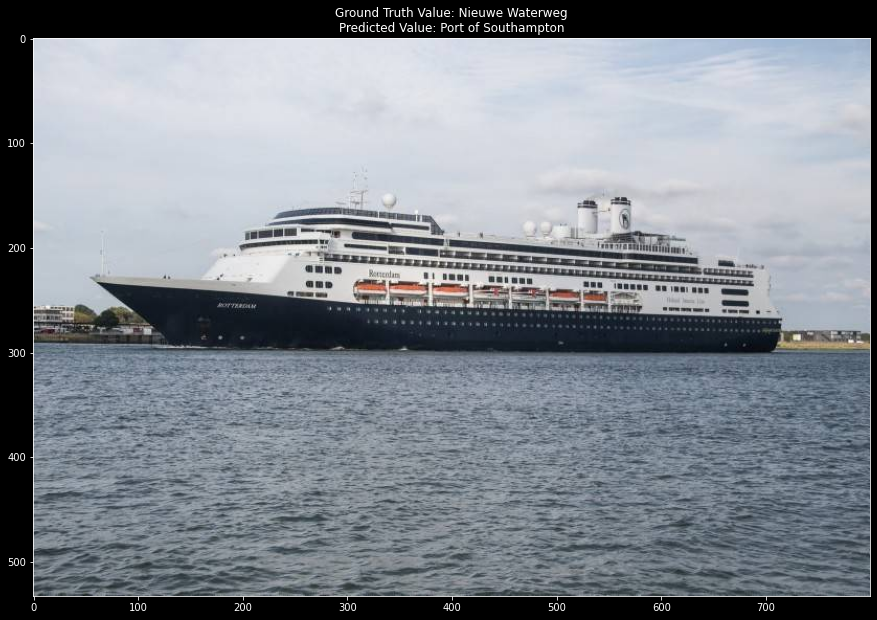


Image Number: 1
Image ID: e02ea67dc1c024ab
Predicted Image WikiMedia Category URL:
http://commons.wikimedia.org/wiki/Category:Savior_Not_Made_by_Hands_hermitage_(Klykovo)


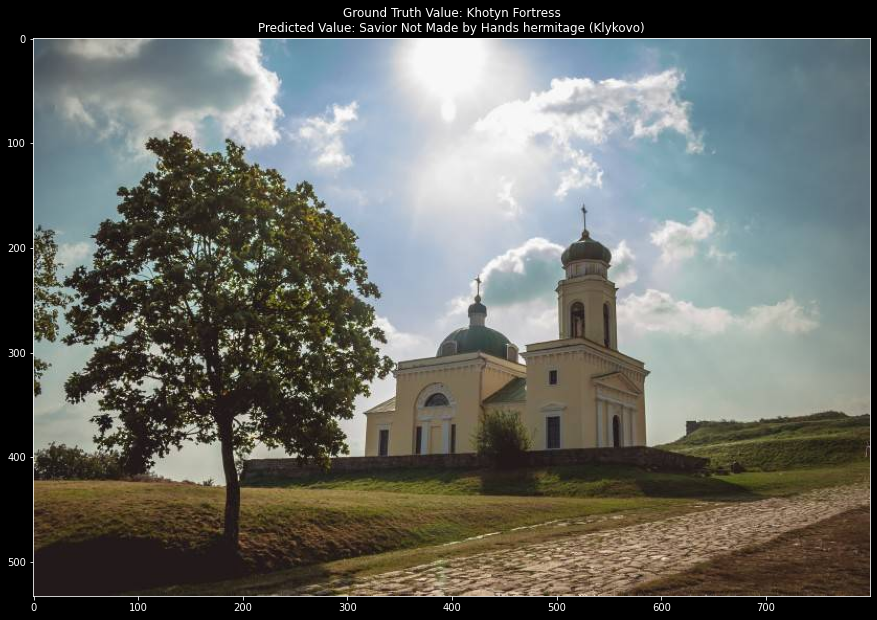


Image Number: 2
Image ID: 16584e8e7916aadb
Predicted Image WikiMedia Category URL:
http://commons.wikimedia.org/wiki/Category:Vimmerby_kyrka


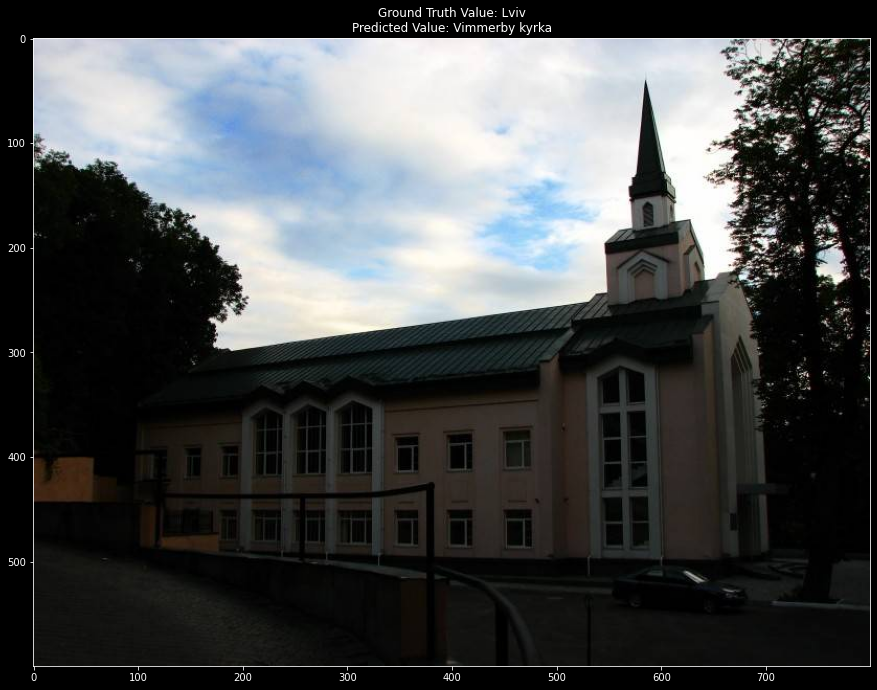


Image Number: 3
Image ID: 45604fe0d15281de
Predicted Image WikiMedia Category URL:
http://commons.wikimedia.org/wiki/Category:St._Lawrence,_Toronto


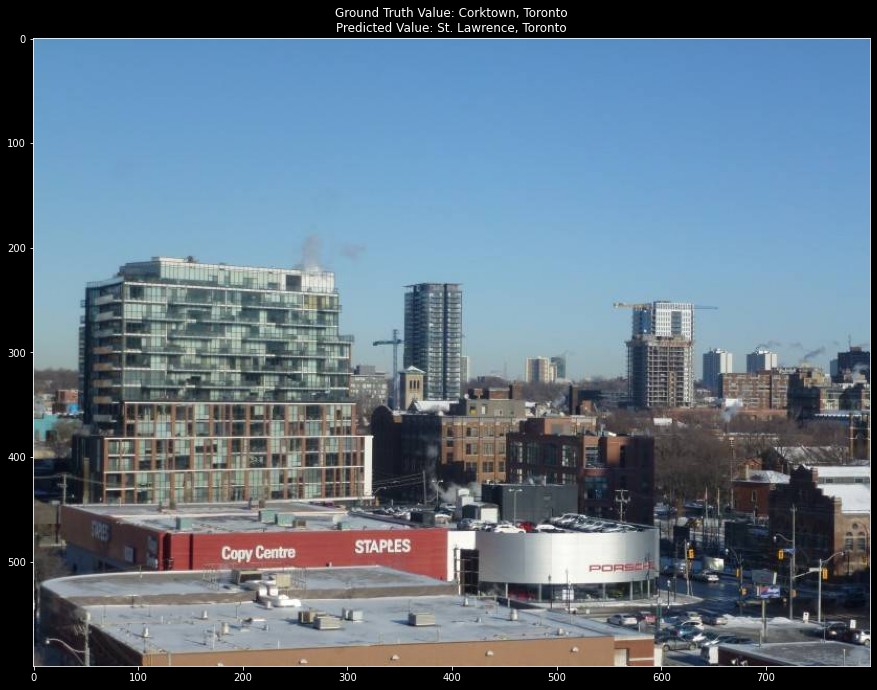


Image Number: 4
Image ID: 15dc67350e8524d6
Predicted Image WikiMedia Category URL:
http://commons.wikimedia.org/wiki/Category:Church_of_the_Holy_Spirit_in_Potelych


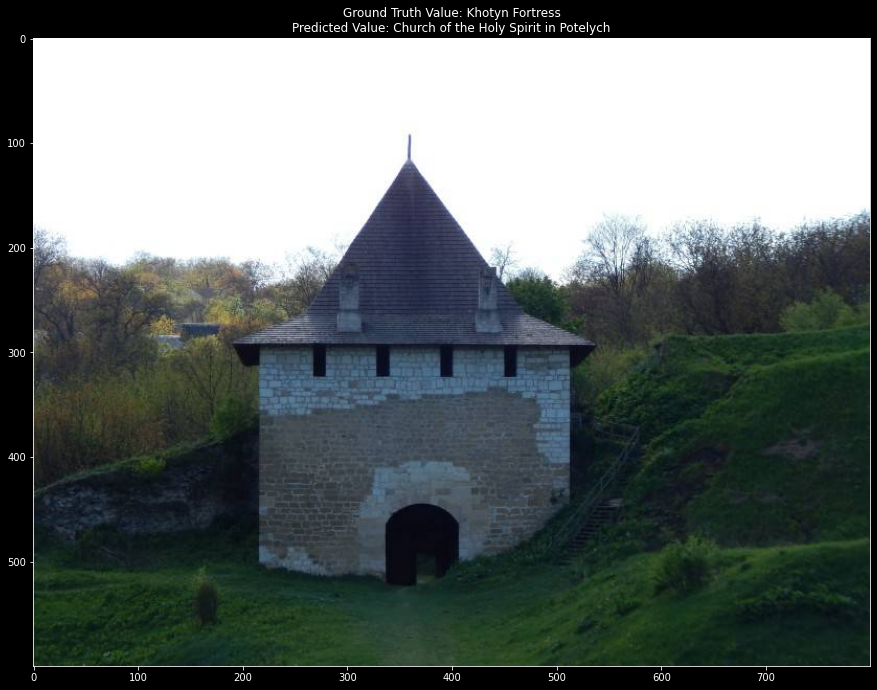


Image Number: 5
Image ID: a0ed7c6f9ec309ad
Predicted Image WikiMedia Category URL:
http://commons.wikimedia.org/wiki/Category:Castle_of_Pambre


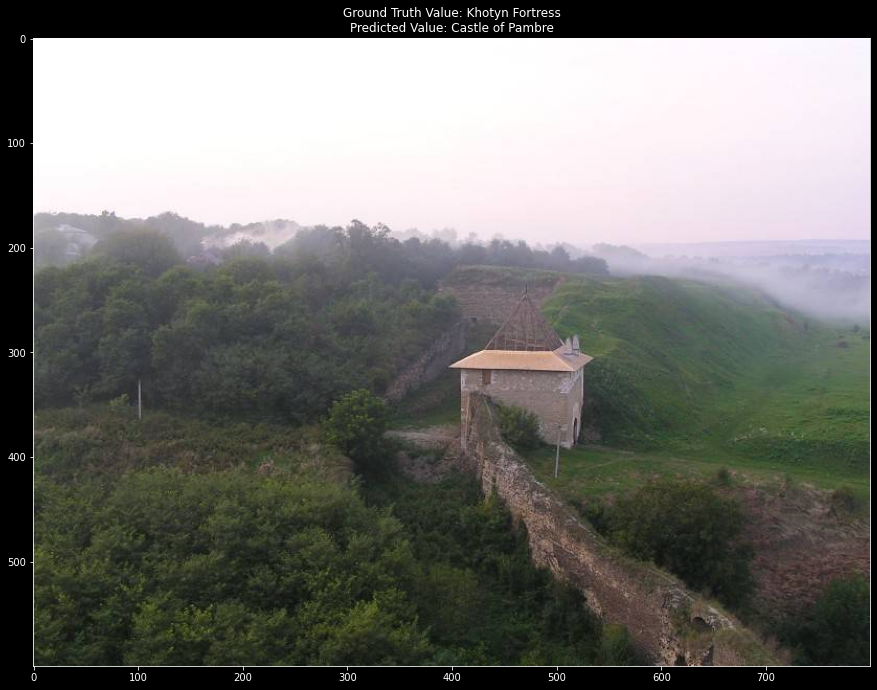


Image Number: 6
Image ID: 2e4b87ca2504a67b
Predicted Image WikiMedia Category URL:
http://commons.wikimedia.org/wiki/Category:Toronto_Harbour


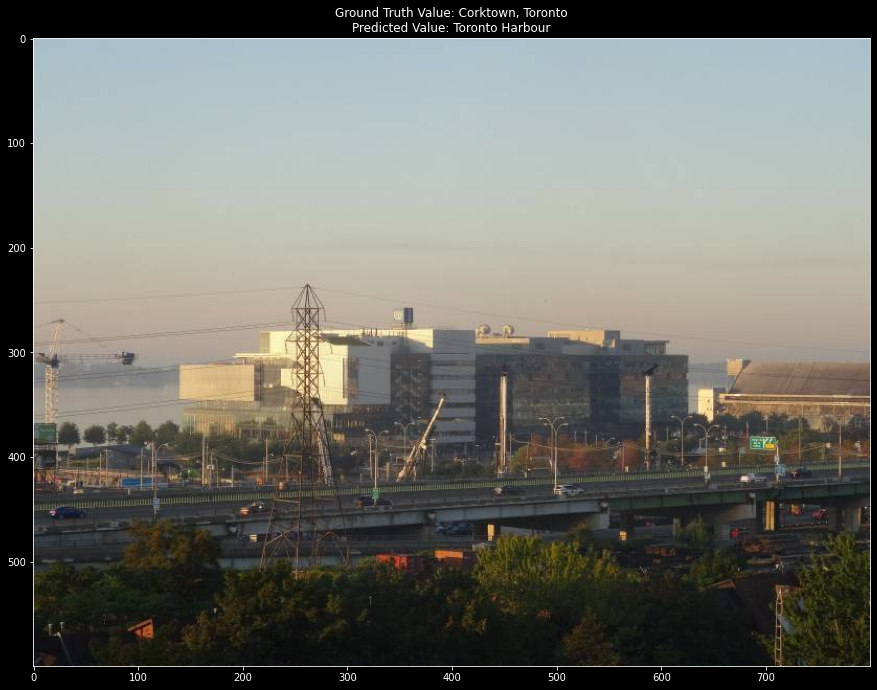


Image Number: 7
Image ID: a014ee22150f2a30
Predicted Image WikiMedia Category URL:
http://commons.wikimedia.org/wiki/Category:Rhine_Falls


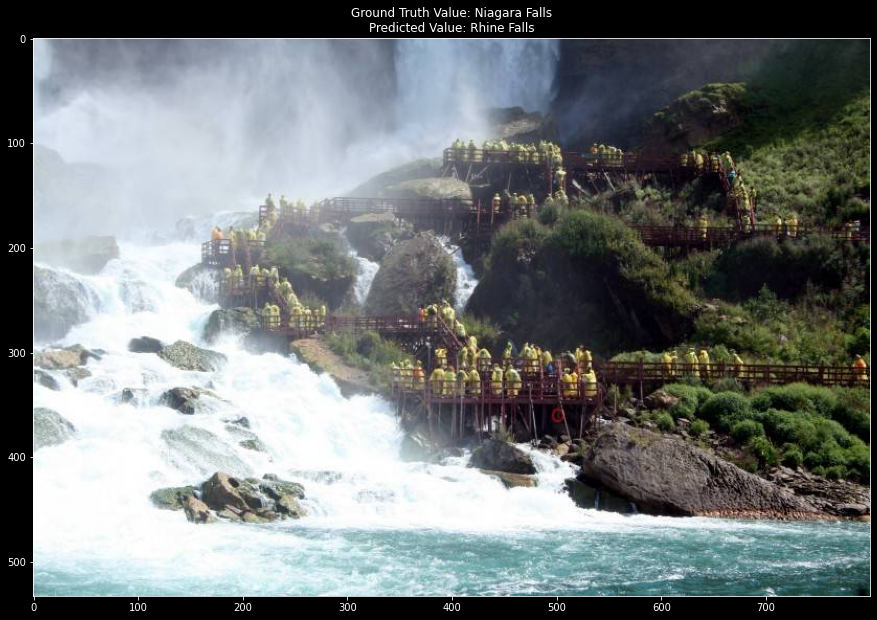


Image Number: 8
Image ID: 0a71c135481761a8
Predicted Image WikiMedia Category URL:
http://commons.wikimedia.org/wiki/Category:Guinness_Storehouse


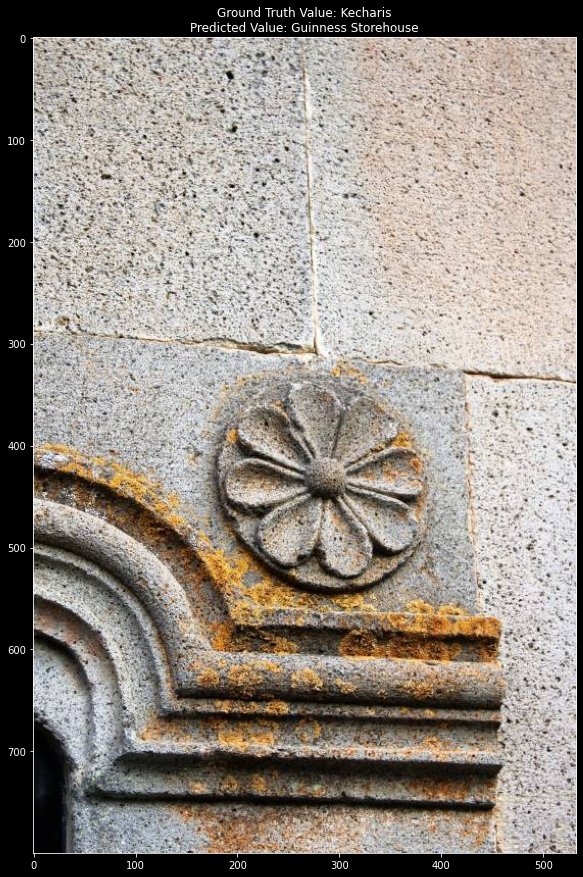


Image Number: 9
Image ID: 4d604186a262f4c6
Predicted Image WikiMedia Category URL:
http://commons.wikimedia.org/wiki/Category:Horseshoe_Falls


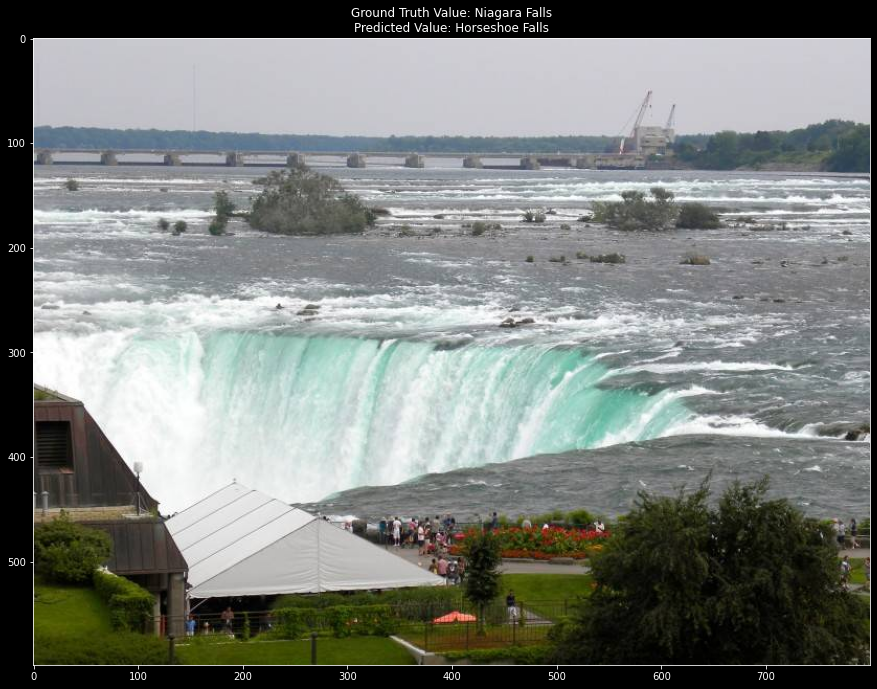


Image Number: 10
Image ID: fdad27923bcf2c15
Predicted Image WikiMedia Category URL:
http://commons.wikimedia.org/wiki/Category:Kefermarkter_Fl%C3%BCgelaltar


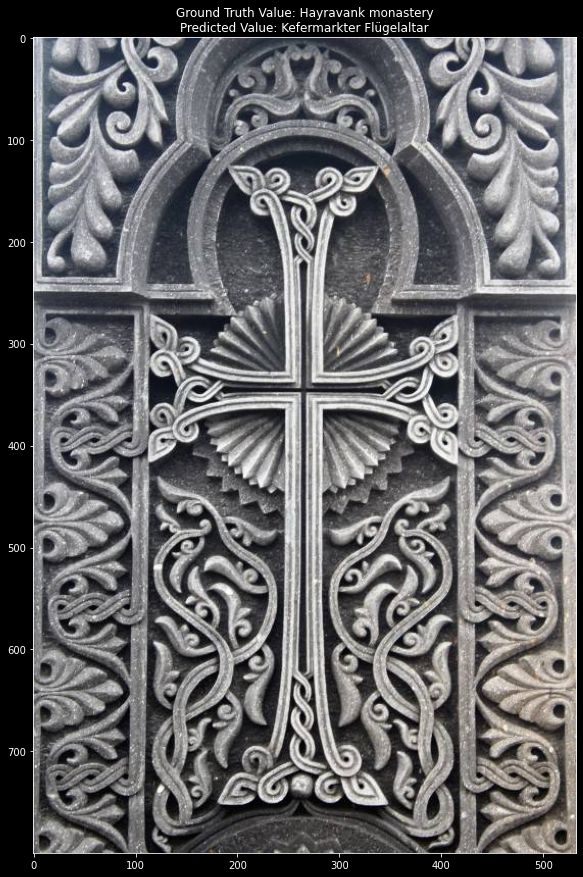


Image Number: 11
Image ID: 0dce887f20355757
Predicted Image WikiMedia Category URL:
http://commons.wikimedia.org/wiki/Category:Belfast_City_Hall


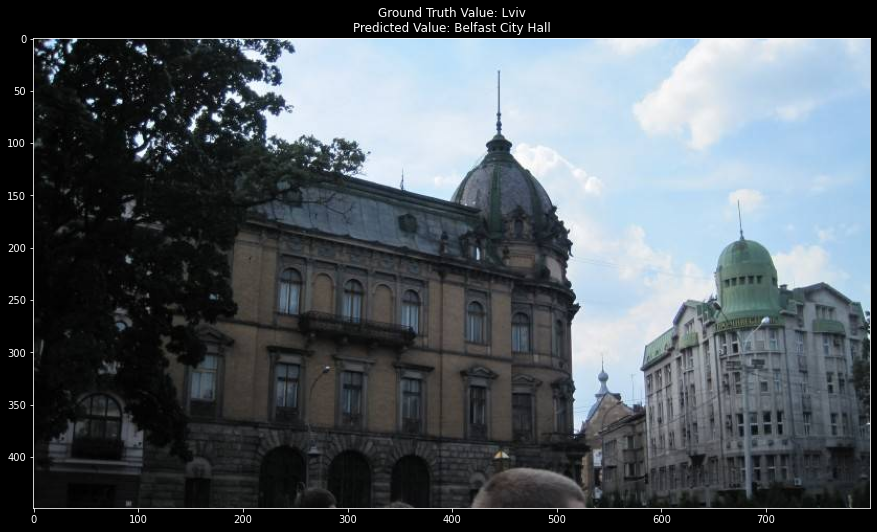


Image Number: 12
Image ID: 66e0b40ddf41be15
Predicted Image WikiMedia Category URL:
http://commons.wikimedia.org/wiki/Category:%C3%8Ele_d'Or


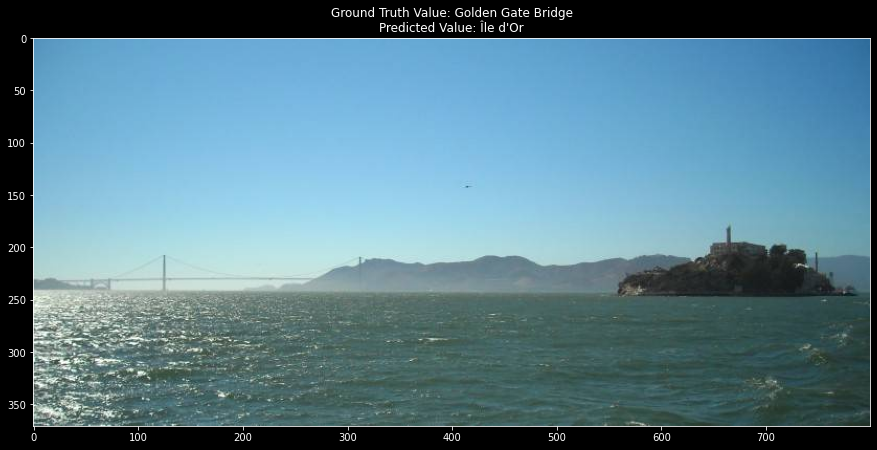


Image Number: 13
Image ID: 1a730234a88f64c1
Predicted Image WikiMedia Category URL:
http://commons.wikimedia.org/wiki/Category:Posk%C3%A6r_Stenhus


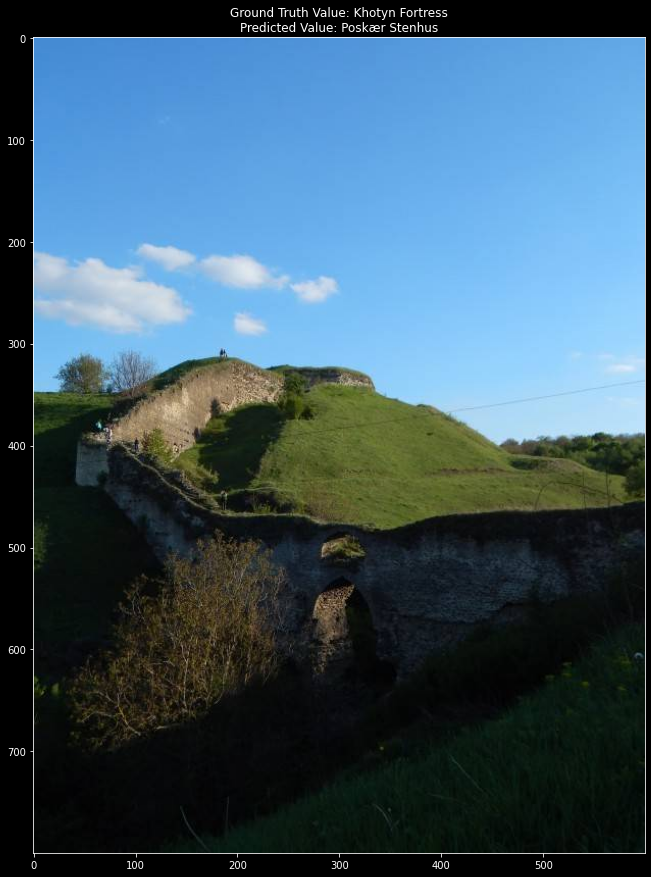


Image Number: 14
Image ID: 941595c76de13071
Predicted Image WikiMedia Category URL:
http://commons.wikimedia.org/wiki/Category:Soni_highlands


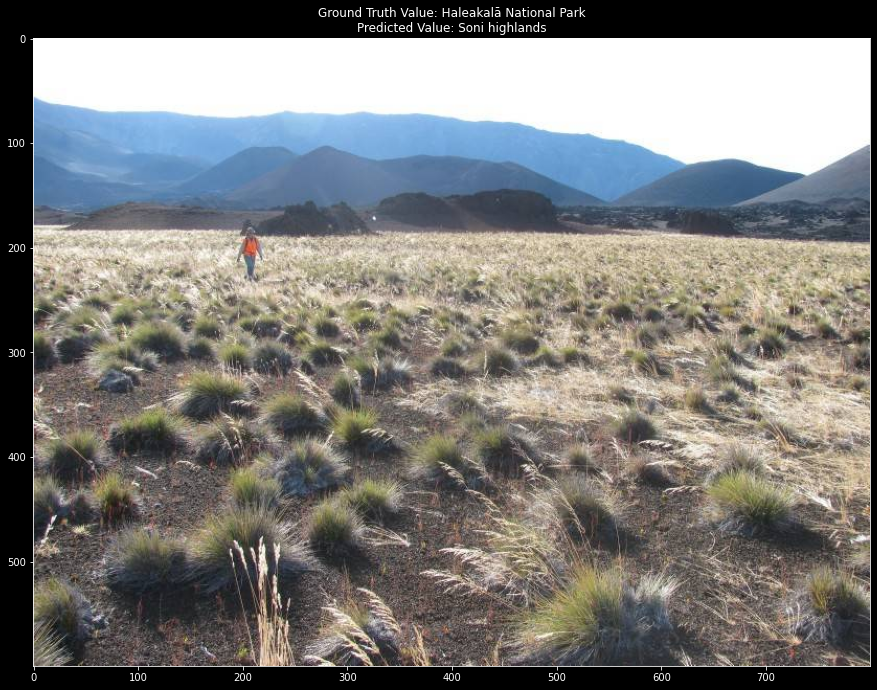


Image Number: 15
Image ID: 949294445c8a27a9
Predicted Image WikiMedia Category URL:
http://commons.wikimedia.org/wiki/Category:State_museum_of_folk_architecture_and_life,_Belarus


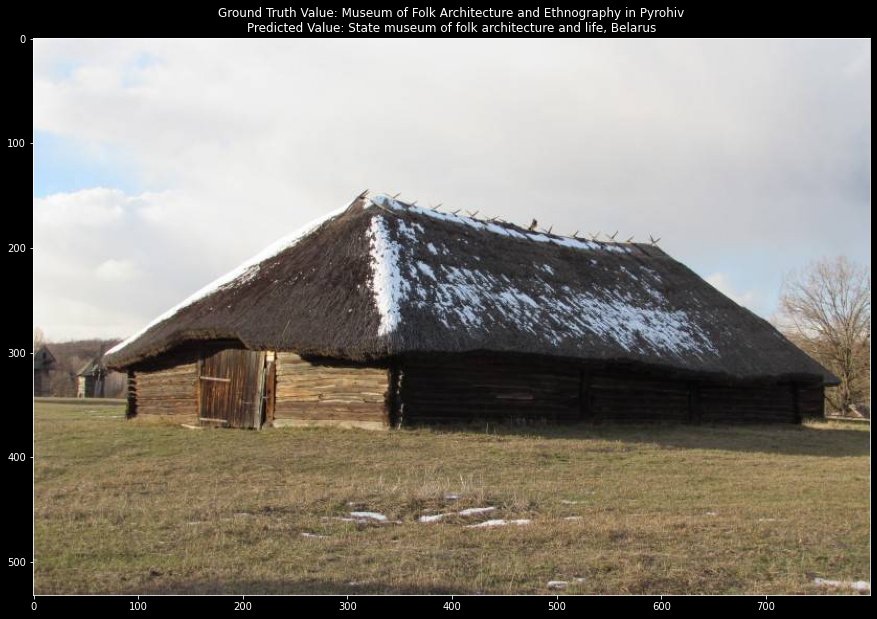


Image Number: 16
Image ID: dfb4f7b9366111ab
Predicted Image WikiMedia Category URL:
http://commons.wikimedia.org/wiki/Category:Ch%C3%A2teau_de_Tours


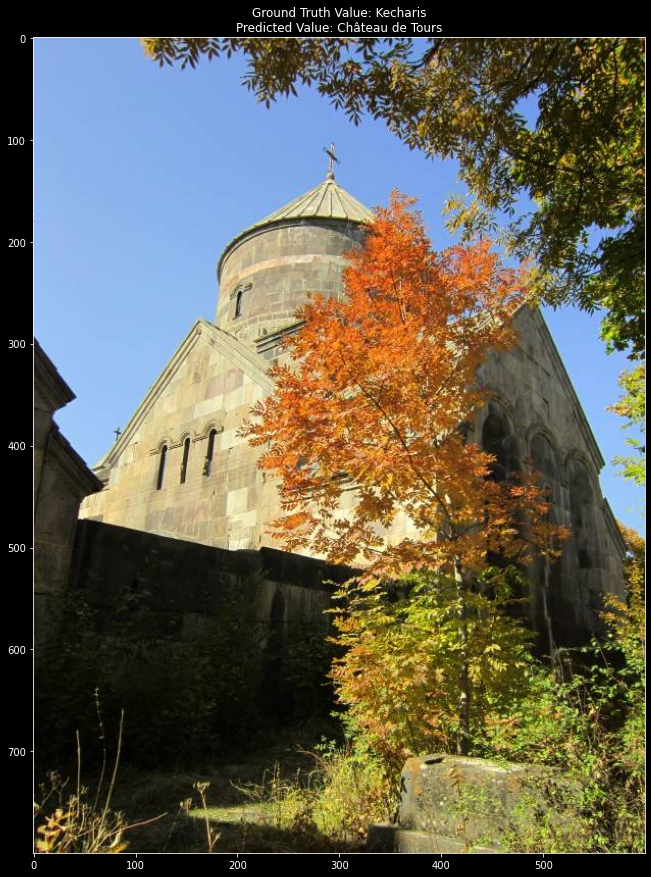


Image Number: 17
Image ID: 192a45b75db78ac4
Predicted Image WikiMedia Category URL:
http://commons.wikimedia.org/wiki/Category:Church_of_Saint_Giles_(Brno-L%C3%AD%C5%A1e%C5%88)


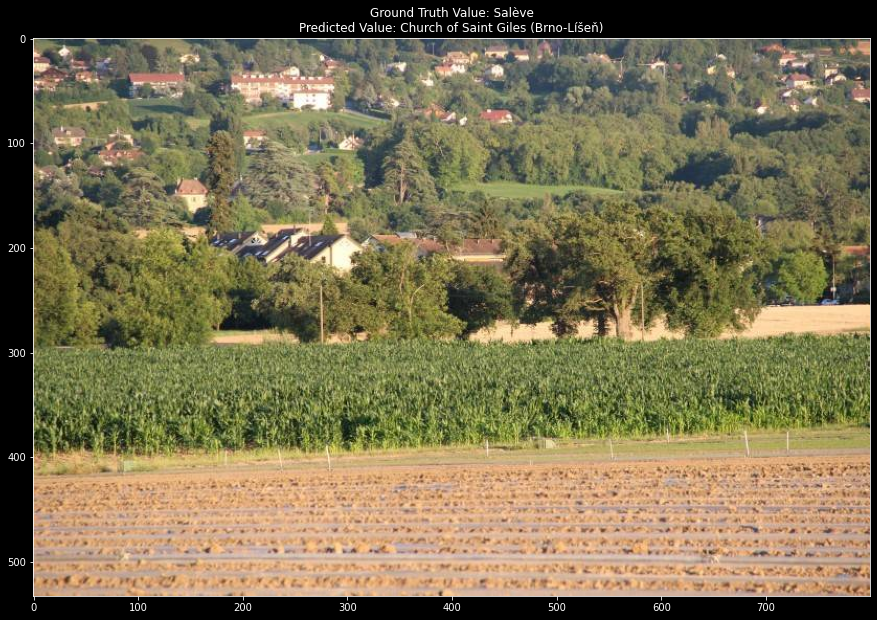


Image Number: 18
Image ID: de5f885041e709c2
Predicted Image WikiMedia Category URL:
http://commons.wikimedia.org/wiki/Category:Mount_Arayat


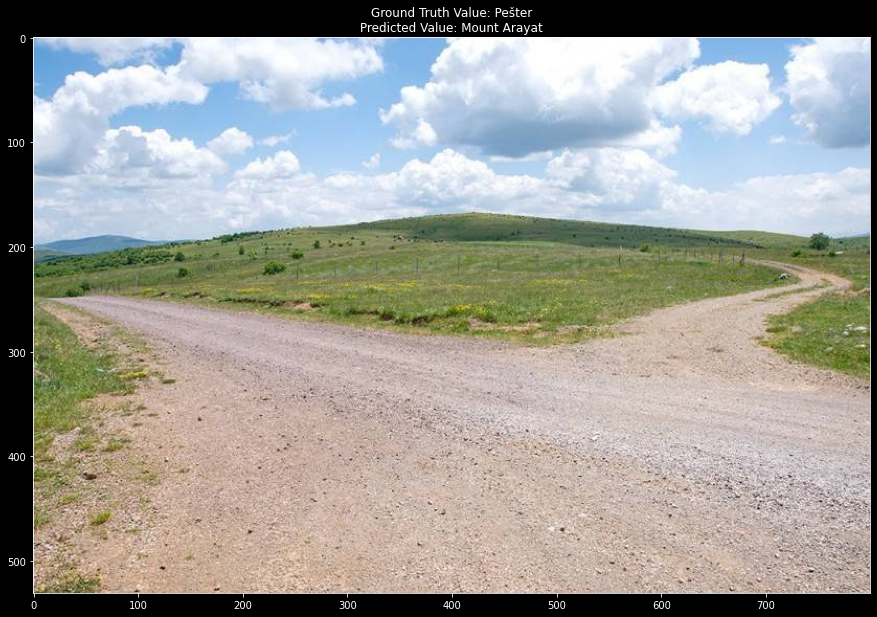


Image Number: 19
Image ID: 8c20d07e64a10a5e
Predicted Image WikiMedia Category URL:
http://commons.wikimedia.org/wiki/Category:Franciscan_Church_of_the_Immaculate_Conception_in_Lviv


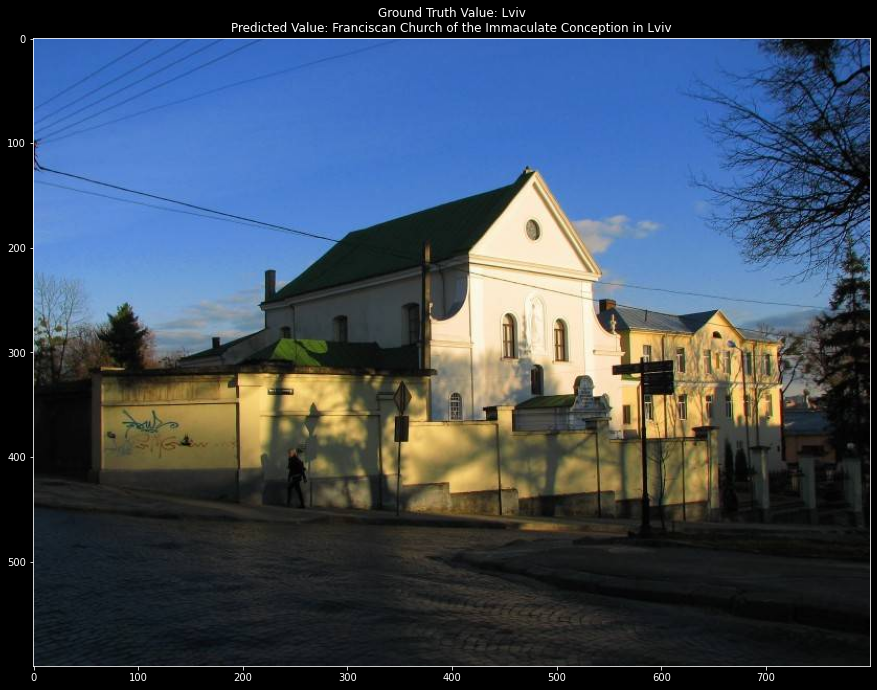


Image Number: 20
Image ID: 180cc2fba76a000d
Predicted Image WikiMedia Category URL:
http://commons.wikimedia.org/wiki/Category:Mulkey_Cemetery


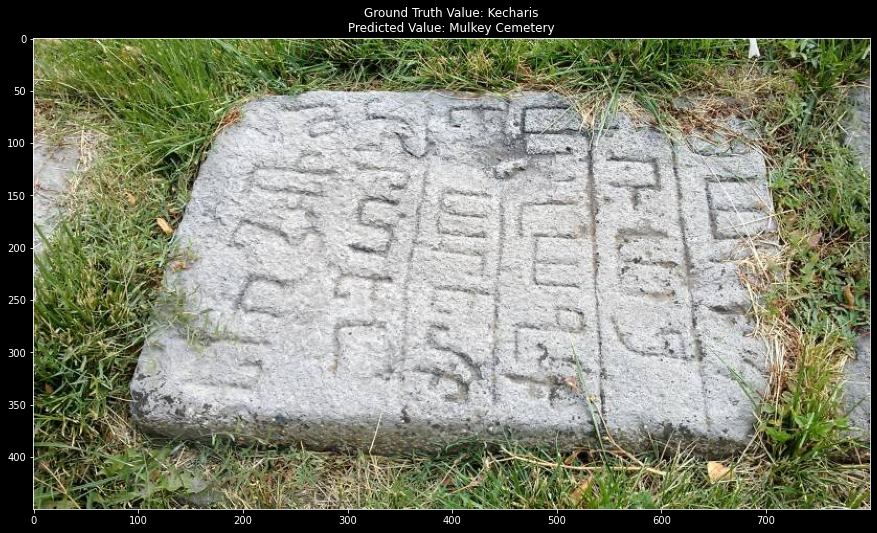


Image Number: 21
Image ID: 53663a8113e4cb12
Predicted Image WikiMedia Category URL:
http://commons.wikimedia.org/wiki/Category:Crystal_City,_Arlington,_Virginia


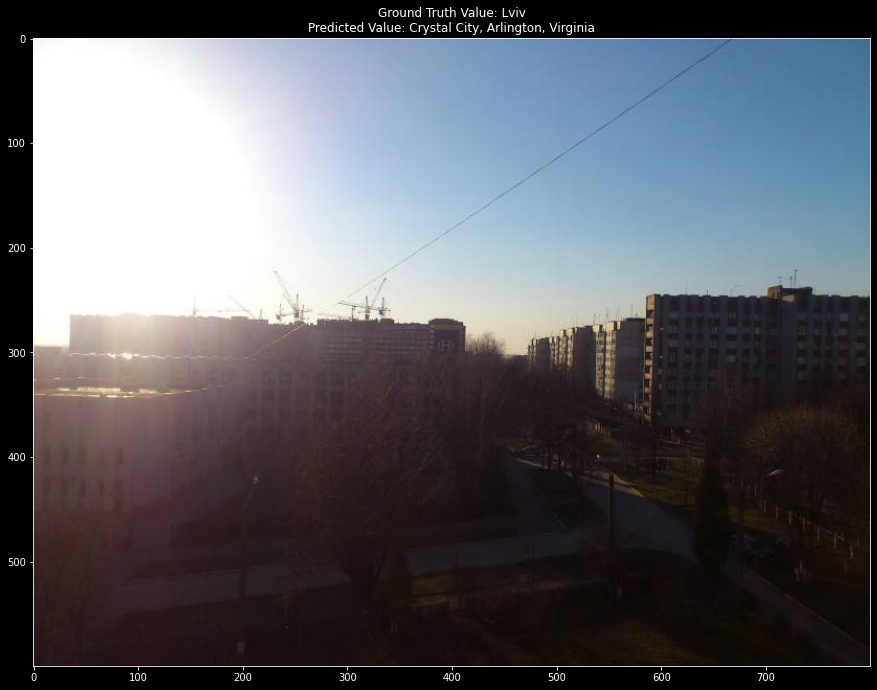


Image Number: 22
Image ID: e403fe652fd18e58
Predicted Image WikiMedia Category URL:
http://commons.wikimedia.org/wiki/Category:Ukrainian_Dramatic_Theatre_of_Maria_Zankovetska


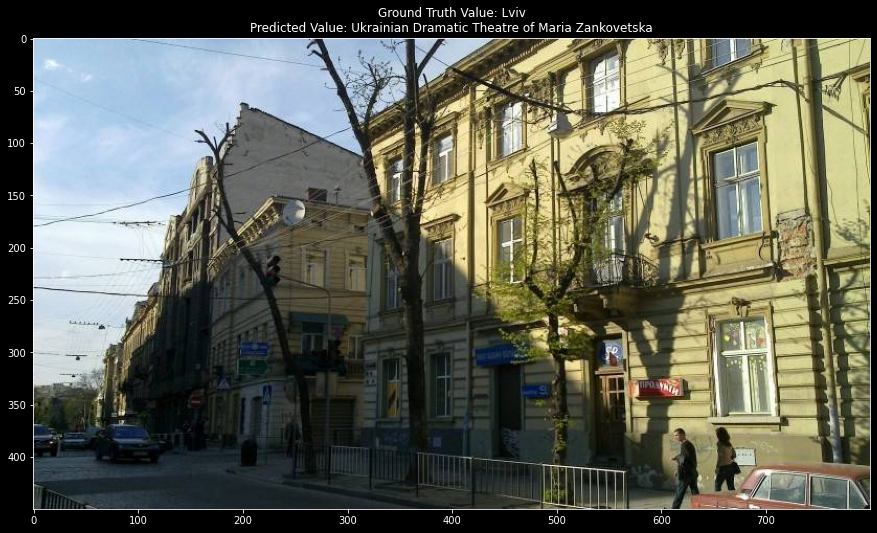


Image Number: 23
Image ID: 607a0acdaef19cf8
Predicted Image WikiMedia Category URL:
http://commons.wikimedia.org/wiki/Category:Templo_de_Santiago_Apostol_de_Lampa


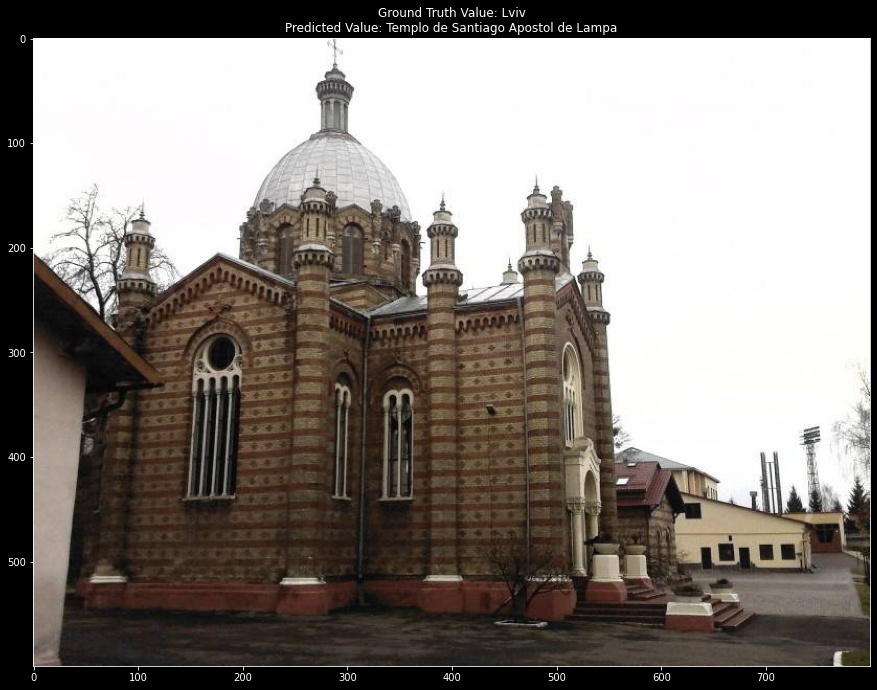


Image Number: 24
Image ID: 44fcb5b849d9d928
Predicted Image WikiMedia Category URL:
http://commons.wikimedia.org/wiki/Category:Samtavro_Monastery


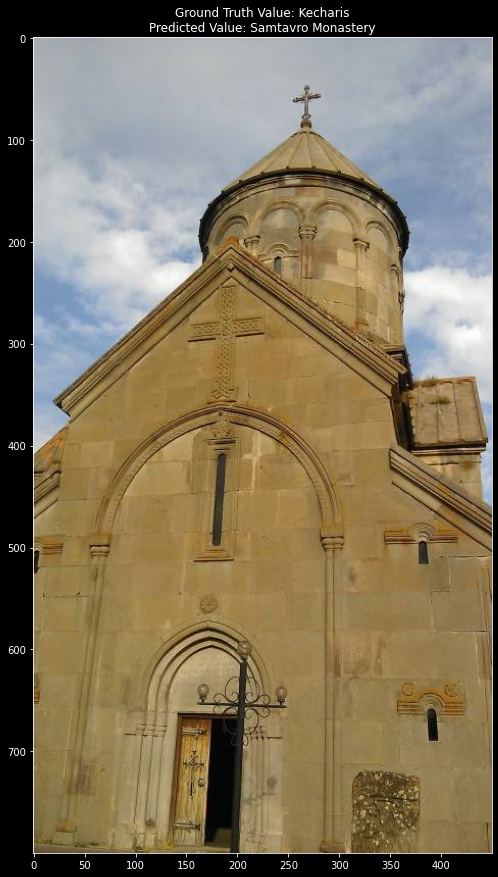


Image Number: 25
Image ID: 71742139bb75d791
Predicted Image WikiMedia Category URL:
http://commons.wikimedia.org/wiki/Category:Z%C3%A1mek_(Nov%C3%A9_M%C4%9Bsto_na_Morav%C4%9B)


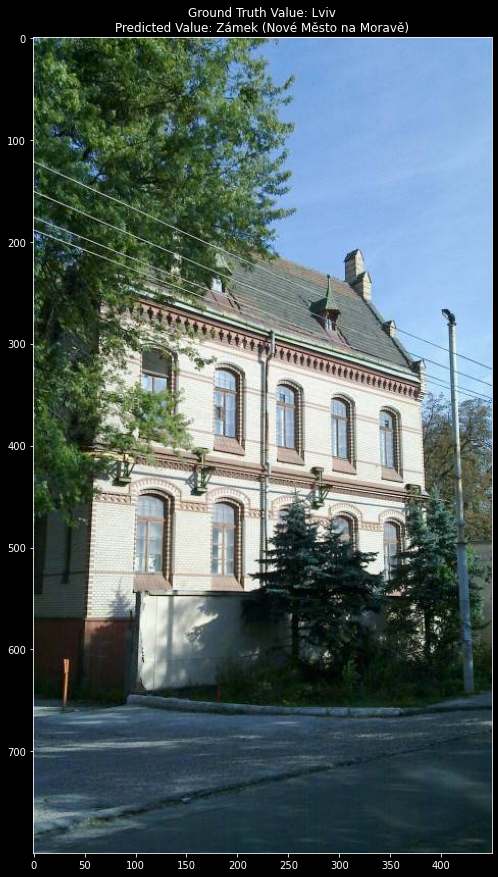


Image Number: 26
Image ID: 5a359a3c4037da16
Predicted Image WikiMedia Category URL:
http://commons.wikimedia.org/wiki/Category:American_Falls


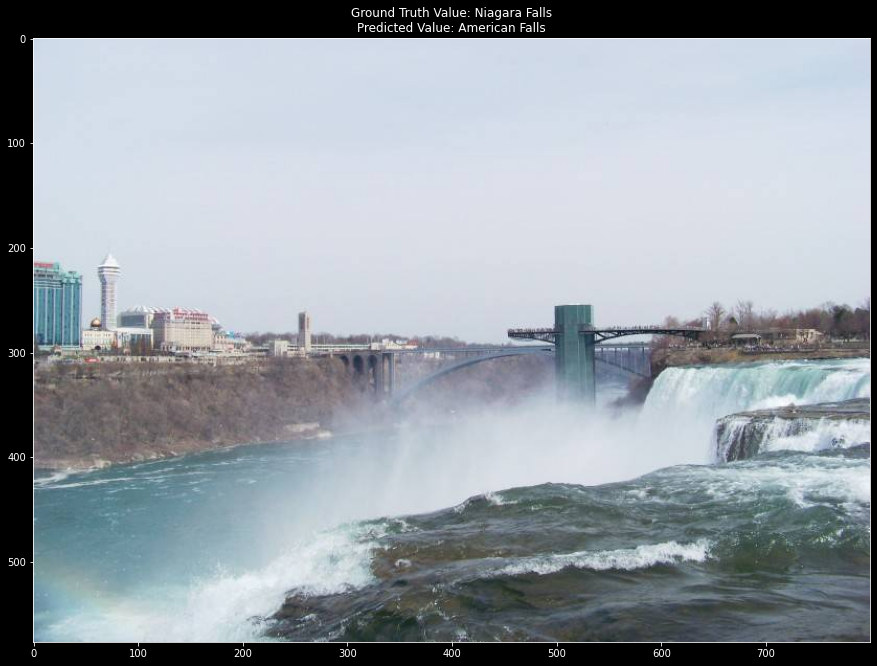

In [20]:
for row in df_sample_wrong.itertuples():
    img = cv2.imread(row.file_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    print("\n" + 150 * "=" + f"\nImage Number: {row.Index}\nImage ID: {row.id}\nPredicted Image WikiMedia Category URL:\n{row.category_pred}")
    plt.figure(figsize=(15, 15))
    plt.title(f"Ground Truth Value: {row.landmark_name_true}\nPredicted Value: {row.landmark_name_pred}")
    plt.imshow(img)
    plt.show()